# HSC Image Differencing 

# DiaSource counts per CCD, Visit and Night

Like https://github.com/lsst-dm/ap_pipe-notebooks/blob/tickets/DM-20187/false_positives/DiaSourceCensusCcdVisitNight.ipynb, this is an exploration of diaSources per visit/CCD/Visit but for the HSC RC2 dataset. 
    
DiaSources can be counted a few different ways:
* All DiaSource Rows
* All DiaSource Rows with no pixel or measurement flags


We assume almost every diaSource is a false positive and therefore DiaSource count is a metric for image subtraction performace. Better perfomance corresponds to lower counts. 


## Image differencing in the stack

* 2013 "Preconvolution" test with simulated and Stripe 82 data: [Becker et al 2013]( https://docushare.lsst.org/docushare/dsweb/Get/LDM-227)
* 2016  with Decam Data: https://dmtn-006.lsst.io/
* 2016 "Decorrelation" test with simulated and decam data. https://dmtn-021.lsst.io/


# 1) Data

We use `/datasets/hsc/repo/rerun/private/yusra/RC2/ap_pipe/w_2019_26_bgSub` HSC-I band, run for tract=9813, the COSMOS ultra deep field. PDR1 includes 33 "good" visits that we run regularly for our RC2 monthly continuous integration testing. They have the same pointing with small dithers. 

Templates were the 11 best seeing images of the 33 visits:
19658, 19660, 19662, 19680, 19682, 19684, 19694, 19696, 30490, 30500, 30502

Visits differenced include:
 1228,  1230,  1232,  1238,  1240,  1242,  1244,  1246,  1248,
19658, 19660, 19662, 19680, 19682, 19684, 19694, 19696, 19698,
19708, 19710, 19712, 30482, 30484, 30486, 30488, 30490, 30492,
30494, 30496, 30498, 30500, 30502, 30504

A complete description of the processing steps can be found at:
https://github.com/lsst-dm/ap_pipe-notebooks/blob/master/false_positives/ap_pipe_HSC_RC2.md

### Relevant configs:
* default: `config.differencer.doDecorrelation=True`
* default: `config.differencer.doPreConvolve=False`
* change: `config.differencer.subtract['al'].kernel.active.spatialBgOrder = 2`
* change: `config.differencer.doAddCalexpBackground = False`


In [1]:
templateVisits = [19658, 19660, 19662, 19680, 19682, 19684, 19694, 19696, 30490, 30500, 30502]

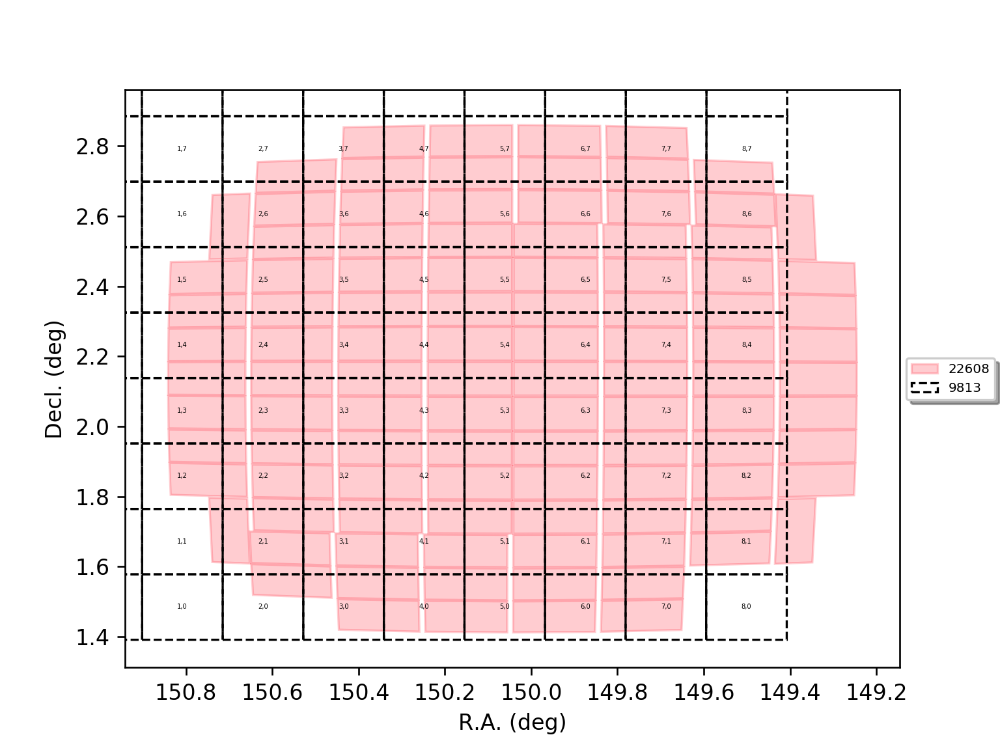

In [2]:
from IPython.display import Image
Image("https://lsst-web.ncsa.illinois.edu/~yusra/deblender-sprint/w_2019_18_4k/logs/9813.png", width=1000)

![HSC CCD Layout](https://hsc.mtk.nao.ac.jp/pipedoc_e/_images/CCDPosition_20140811-1.png)


## Load and Transform Data

In [3]:
import os
import numpy as np
import scipy
import matplotlib.pyplot as plt
import pandas as pd
import sqlite3
import lsst.daf.persistence as dafPersist
import lsst.afw.display as afwDisplay
import lsst.geom
afwDisplay.setDefaultBackend('matplotlib')
import matplotlib.ticker as plticker
import lsst.afw.cameraGeom.testUtils as testUtils
import lsst.afw.cameraGeom as cameraGeom
from lsst.obs.hsc import HscMapper as mapper

In [4]:
# Most Recent Hits2015 rerun with default tasks and configs
REPO = '/datasets/hsc/repo/rerun/private/yusra/RC2/ap_pipe/w_2019_26_bgSub'

# Connect to the PPDB
connection = sqlite3.connect(f'{REPO}/association.db')
# Make a butler
butler = dafPersist.Butler(REPO)

In [5]:
# get columns
columns = pd.read_sql_query('select * from DiaSource limit 1', connection).columns

In [6]:
# get diaSources (ALL)
ds = pd.read_sql_query("""select ccdVisitId, ra, decl, psFlux, psFluxErr, midPointTai, 
x, y, ixxPSF, iyyPSF, ixyPSF, flags, snr, apFlux, apFluxErr, 
dipMeanFlux, dipMeanFluxErr, dipFluxDiff, 
dipFluxDiffErr, dipMeanFlux_dipFluxDiff_Cov, 
totFlux, totFluxErr, diffFlux, diffFluxErr 
from DiaSource where filterId=4""", connection)

In [7]:
columns

Index(['diaSourceId', 'ccdVisitId', 'diaObjectId', 'ssObjectId',
       'parentDiaSourceId', 'prv_procOrder', 'ssObjectReassocTime',
       'midPointTai', 'ra', 'raErr',
       ...
       'ixxPSF', 'iyyPSF', 'ixyPSF', 'extendedness', 'spuriousness', 'flags',
       'pixelId', 'filterName', 'filterId', 'isDipole'],
      dtype='object', length=111)

In [8]:
# create some derived columns

ds['visit'] = ds.ccdVisitId.apply(lambda x: int(x/200.))
ds['ccd'] = ds.ccdVisitId.apply(lambda x: int(np.round((x/200. - int(x/200.))*200)))

SIGMA2FWHM = 2*np.sqrt(2*np.log(2))
PIXEL_SCALE = 0.168
traceRadius = np.sqrt(0.5) * np.sqrt(ds.ixxPSF + ds.iyyPSF)
ds['seeing'] = SIGMA2FWHM * traceRadius

In [9]:
# get Focal Plane Coordinates (is there a faster way to do this?)
camera = mapper(root=REPO).camera

def ccd2focalPlane(x, y, ccd):
    cc = int(ccd)
    det = camera[cc]
    point = det.transform(lsst.geom.Point2D(x, y), cameraGeom.PIXELS, cameraGeom.FOCAL_PLANE)
    return point[0], point[1]

vecCcd2FP =  np.vectorize(ccd2focalPlane)
focal_plane = vecCcd2FP(ds['x'].values.astype(float), ds['y'].values.astype(float), ds['ccd'].values.astype(int))
ds['xFP'] = focal_plane[0]
ds['yFP'] = focal_plane[1]

In [10]:
visits = np.unique(ds.visit)
goodCcds = np.unique(ds.ccd[(ds.xFP > -8000) & (ds.xFP < 8000) & (ds.yFP > -10000) & (ds.yFP < 10000)])
bbox = butler.get('calexp_bbox', visit = int(visits[0]), ccd = 49)
APPROX_CCD_AREA = PIXEL_SCALE*PIXEL_SCALE*bbox.getArea()/3600/3600
APPROX_N_CCD = 92
N_GOOD_CCD = len(goodCcds) # 54
APPROX_VISIT_AREA = APPROX_CCD_AREA * APPROX_N_CCD
GOOD_VISIT_AREA = APPROX_CCD_AREA * N_GOOD_CCD

In [11]:
# Get flags
from lsst.ap.association import UnpackPpdbFlags, MapDiaSourceConfig
config = MapDiaSourceConfig()
unpacker = UnpackPpdbFlags(config.flagMap, 'DiaSource')
flag_values = unpacker.unpack(ds['flags'], 'flags')
flag_names = list(flag_values.dtype.names)
flagDF = pd.DataFrame(flag_values)
flagDF.head()

/software/lsstsw/stack_20190330/stack/miniconda3-4.5.12-1172c30/Linux64/ap_association/17.0.1-6-ga2de75c+7/python/lsst/ap/association/mapApData.py:388: YAMLLoadWarning: calling yaml.load_all() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  table_list = list(yaml.load_all(yaml_stream))


,base_PixelFlags_flag,base_PixelFlags_flag_offimage,base_PixelFlags_flag_edge,base_PixelFlags_flag_interpolated,base_PixelFlags_flag_saturated,base_PixelFlags_flag_cr,base_PixelFlags_flag_bad,base_PixelFlags_flag_suspect,base_PixelFlags_flag_interpolatedCenter,base_PixelFlags_flag_saturatedCenter,...,slot_PsfFlux_flag_edge,ip_diffim_forced_PsfFlux_flag,ip_diffim_forced_PsfFlux_flag_noGoodPixels,ip_diffim_forced_PsfFlux_flag_edge,slot_Shape_flag,slot_Shape_flag_unweightedBad,slot_Shape_flag_unweighted,slot_Shape_flag_shift,slot_Shape_flag_maxIter,slot_Shape_flag_psf
0,False,False,False,True,True,True,False,True,True,True,...,False,False,False,False,True,True,False,False,False,False
1,False,False,True,True,True,True,False,True,True,True,...,False,False,False,False,True,True,False,False,False,False
2,False,False,False,True,False,True,False,False,True,False,...,False,False,False,False,True,True,False,False,False,False
3,False,False,False,True,False,True,False,False,True,False,...,False,False,False,False,True,True,False,False,False,False
4,False,False,False,True,False,True,False,False,True,False,...,False,False,False,False,True,True,False,False,False,False


In [12]:
pixelFlagNames = ['base_PixelFlags_flag',
 'base_PixelFlags_flag_offimage',
 'base_PixelFlags_flag_edge',
 'base_PixelFlags_flag_interpolated',
 'base_PixelFlags_flag_saturated',
 'base_PixelFlags_flag_cr',
 'base_PixelFlags_flag_bad',
 'base_PixelFlags_flag_suspect',
 'base_PixelFlags_flag_interpolatedCenter',
 'base_PixelFlags_flag_saturatedCenter',
 'base_PixelFlags_flag_crCenter',
 'base_PixelFlags_flag_suspectCenter',]
centroidFlagNames = ['slot_Centroid_flag',
 'slot_Centroid_pos_flag',
 'slot_Centroid_neg_flag',]
fluxFlagNames = ['slot_ApFlux_flag',
 'slot_ApFlux_flag_apertureTruncated',
 'slot_PsfFlux_flag',
 'slot_PsfFlux_flag_noGoodPixels',
 'slot_PsfFlux_flag_edge',
 'ip_diffim_forced_PsfFlux_flag',
 'ip_diffim_forced_PsfFlux_flag_noGoodPixels',
 'ip_diffim_forced_PsfFlux_flag_edge',]
shapeFlagNames =  ['slot_Shape_flag',
 'slot_Shape_flag_unweightedBad',
 'slot_Shape_flag_unweighted',
 'slot_Shape_flag_shift',
 'slot_Shape_flag_maxIter',
 'slot_Shape_flag_psf']

badFlagNames = ['base_PixelFlags_flag_saturated', 
                'base_PixelFlags_flag_suspect',
                'base_PixelFlags_flag_bad',
                'slot_Shape_flag']

In [13]:
def plot2axes(x1, y1, x2, y2, xlabel, ylabel1, ylabel2):
    fig, ax1 = plt.subplots(figsize=(16,6))
    color = 'tab:red'
    ax1.set_xlabel(xlabel)
    ax1.set_ylabel(ylabel1, color=color)
    a = np.arange(len(x1))
    ax1.plot(a, y1, color=color)
    ax1.xaxis.set_ticks(a) #set the ticks to be a
    ax1.xaxis.set_ticklabels(x1)
    
    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel(ylabel2, color=color)  # we already handled the x-label with ax1
    ax2.plot(a, y2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    for label in ax1.get_xticklabels():
        label.set_ha("right")
        label.set_rotation(90)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

# 2)  DiaSources per visit

A few different ways to look at false positives as a function of visits. Most of the variance in diaSources can be explained by the seeing. If the visit PSF is smaller than the template PSF, the template PSF is deconvolved, in which any inaccuracy in the PSF model is amplified. This causes the clear relationship below where false positives improve as the PSF size increases:

In [14]:
idx = flagDF[badFlagNames].sum(axis = 1) == 0 
idxGoodCcd = ds.ccd.isin(goodCcds)
idxHighSNR = idx & idx & (ds.dipMeanFlux/ds.dipMeanFluxErr > 5)

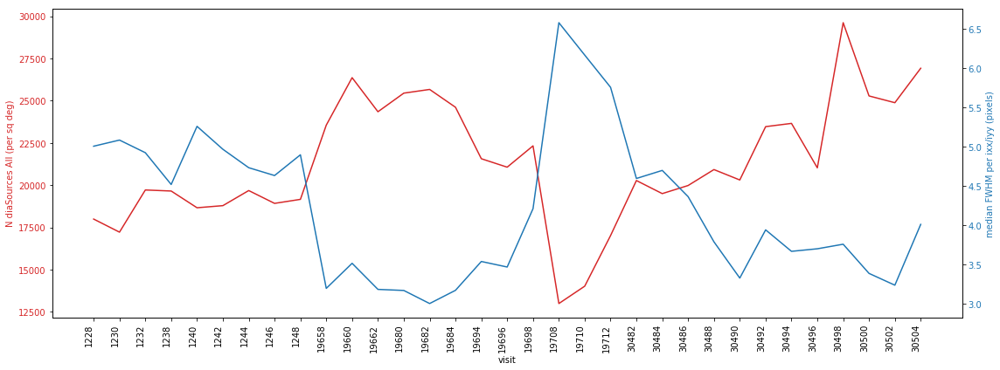

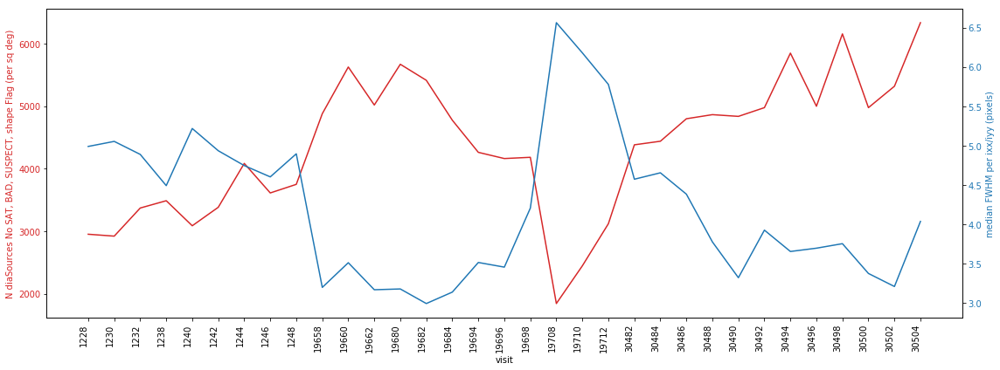

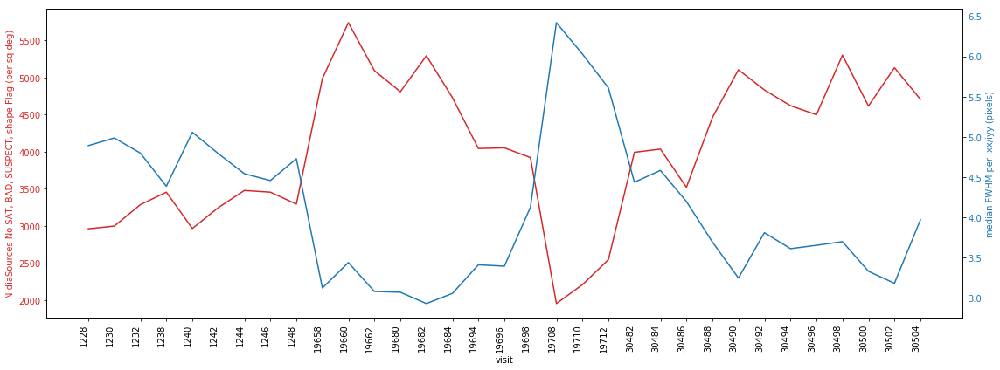

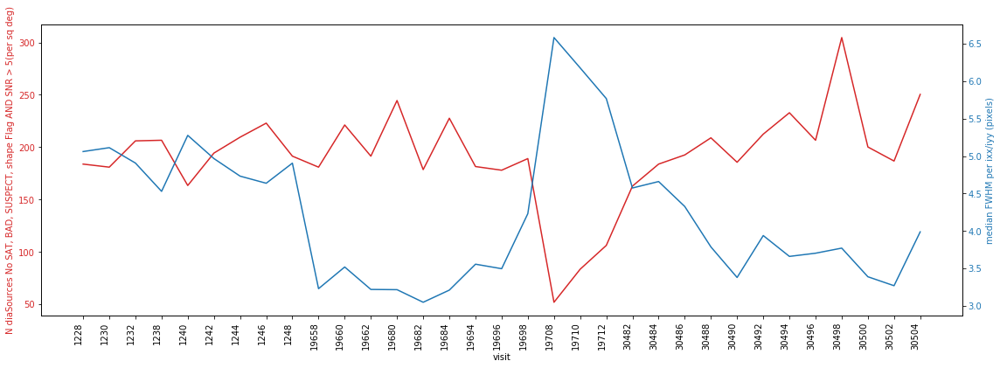

In [15]:

vgrp = ds.groupby('visit')
vgrpClean = ds[idx].groupby('visit')
vgrpCleanCenter = ds[idx & idxGoodCcd].groupby('visit')
vgrpHighSNR = ds[idxHighSNR].groupby('visit')

plot2axes(vgrp.visit.first().values, vgrp.ccd.count().values/APPROX_VISIT_AREA,
          vgrp.visit.first().values, vgrp.seeing.median().values,
          'visit','N diaSources All (per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

plot2axes(vgrpClean.visit.first().values, vgrpClean.ccd.count().values/APPROX_VISIT_AREA,
          vgrpClean.visit.first().values, vgrpClean.seeing.median().values,
          'visit','N diaSources No SAT, BAD, SUSPECT, shape Flag (per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

plot2axes(vgrpCleanCenter.visit.first().values, vgrpCleanCenter.ccd.count().values/GOOD_VISIT_AREA,
          vgrpCleanCenter.visit.first().values, vgrpCleanCenter.seeing.median().values/GOOD_VISIT_AREA,
          'visit','N diaSources No SAT, BAD, SUSPECT, shape Flag (per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

plot2axes(vgrpHighSNR.visit.first().values, vgrpHighSNR.ccd.count().values/APPROX_VISIT_AREA,
          vgrpHighSNR.visit.first().values, vgrpHighSNR.seeing.median().values,
          'visit','N diaSources No SAT, BAD, SUSPECT, shape Flag AND SNR > 5(per sq deg)',
          'median FWHM per ixx/iyy (pixels)')

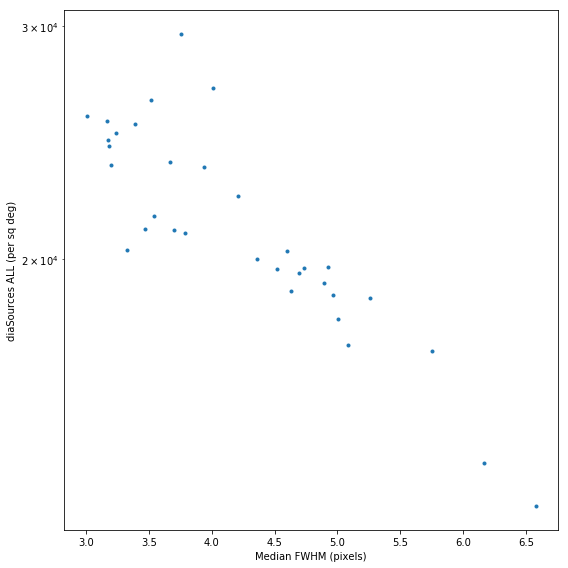

In [16]:
templateSeeingDist = ds.seeing[ds.visit.isin(templateVisits)]
plt.figure(figsize=(8,8))
plt.plot(vgrp.seeing.median().values, vgrp.ccd.count().values/APPROX_VISIT_AREA, '.', label="ALL")
plt.yscale('log')
plt.ylabel('diaSources ALL (per sq deg)')
plt.xlabel('Median FWHM (pixels)')
plt.tight_layout()

In [17]:
def n(v):
    return v*np.exp(-0.5*v*v)/(2**(5/2) * np.pi**(3/2))

def expected(low, high, seeing=3, nCcds=len(visits)*APPROX_N_CCD):
    """seeing must be supplied as sigma)
    """
    inBetween = n(low) - n(high)
    return inBetween * 2 * nCcds * bbox.getWidth()*bbox.getHeight() / (seeing**2)

seeingRange = np.linspace(np.min(vgrp.seeing.median().values/SIGMA2FWHM), 
                   np.max(vgrp.seeing.median().values/SIGMA2FWHM),
                   20)
expectedCounts = expected(5, 100, seeingRange)/ 33 / APPROX_VISIT_AREA

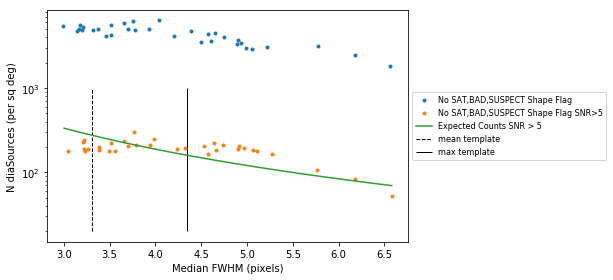

In [18]:
templateSeeingDist = ds.seeing[ds.visit.isin(templateVisits)]
plt.figure(figsize=(8,4))
ax = plt.subplot(111)
plt.yscale('log')
plt.ylabel('N diaSources (per sq deg)')
plt.xlabel('Median FWHM (pixels)')
plt.plot(vgrpClean.seeing.median().values, vgrpClean.ccd.count().values/APPROX_VISIT_AREA, '.', label="No SAT,BAD,SUSPECT Shape Flag")
plt.plot(vgrpHighSNR.seeing.median().values, vgrpHighSNR.ccd.count().values/APPROX_VISIT_AREA, '.', label="No SAT,BAD,SUSPECT Shape Flag SNR>5")
plt.vlines(templateSeeingDist.mean(), 20, 1000, linestyles='dashed', label="mean template", linewidth=1)
plt.vlines(templateSeeingDist.max(), 20, 1000, linestyles='solid', label="max template", linewidth=1)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])
plt.plot(seeingRange*SIGMA2FWHM, expectedCounts, label="Expected Counts SNR > 5")
plt.legend(fontsize=8, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()

# DiaSources per CCD

In [19]:
vgrp = ds.groupby('ccd')
vgrpClean = ds[idx].groupby('ccd')
vgrpHighSNR = ds[idxHighSNR].groupby('ccd')
NVisits = len(np.unique(ds['visit'].values))

In [20]:
# Get corners of the ccds. You can prob do this with camera geom too. 
cornerList = []
v = ds['visit'][0]
for ccd in range(0, 104):
    try:
        bbox = butler.get('calexp_bbox', visit=int(v), ccd=ccd)
    except:
        print(ccd)
        continue
    cornerList.append( [int(v), ccd] + [val for pair in bbox.getCorners() for val in ccd2focalPlane(pair[0], pair[1], ccd)])


corners = pd.DataFrame(cornerList)
cornerList
corners['width'] = corners[6] - corners[8]
corners['height'] = corners[7] - corners[5]

9


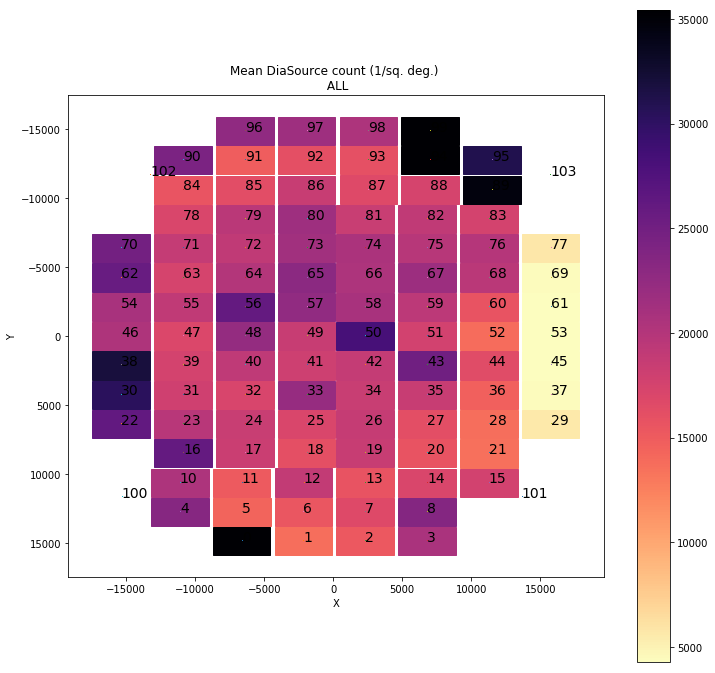

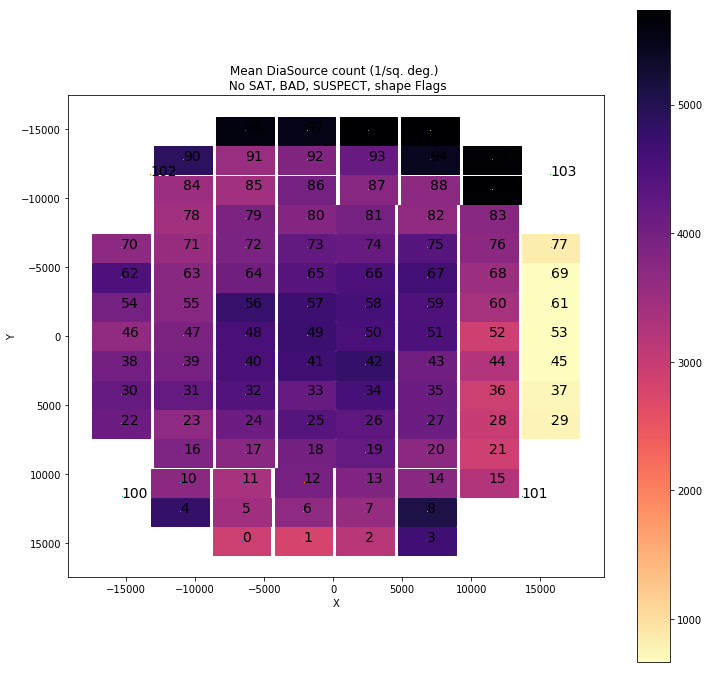

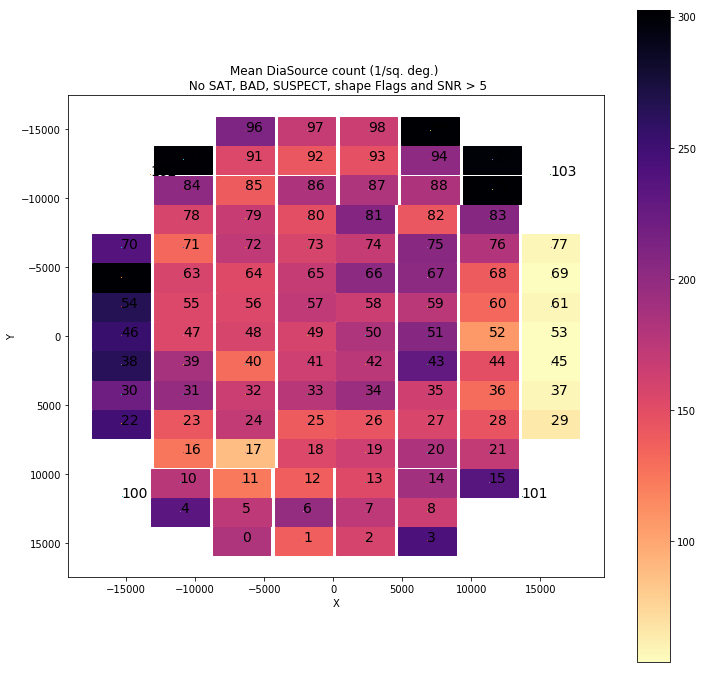

In [21]:
import matplotlib.patches as patches
import matplotlib as mpl
cmap = mpl.cm.magma_r

for grp, title in [(vgrp, "ALL"),
                   (vgrpClean, "No SAT, BAD, SUSPECT, shape Flags"),
                   (vgrpHighSNR, "No SAT, BAD, SUSPECT, shape Flags and SNR > 5")]:
    yy = grp.visit.count().values/NVisits/APPROX_CCD_AREA
    vmin, vmax = np.percentile(yy, (2, 98))
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)


    fig1 = plt.figure(figsize=(12,12))
    ax1 = fig1.add_subplot(111, aspect='equal')
    for index, row in corners.iterrows():
        try:
            avgFP = grp.get_group(int(row[1])).x.count()/NVisits/APPROX_CCD_AREA
        except KeyError:
            avgFP = 0
        #print(row[1], avgFP)
        ax1.add_patch(
        patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=True,
                          color=cmap(norm(avgFP))))
        ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
        plt.plot(row[7]-row.height/2, row[6]-row.width/2, ',')
    ax1.set_title('Mean DiaSource count (1/sq. deg.) \n %s' %(title))
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
   # ax1.invert_xaxis()
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm)
    plt.show()

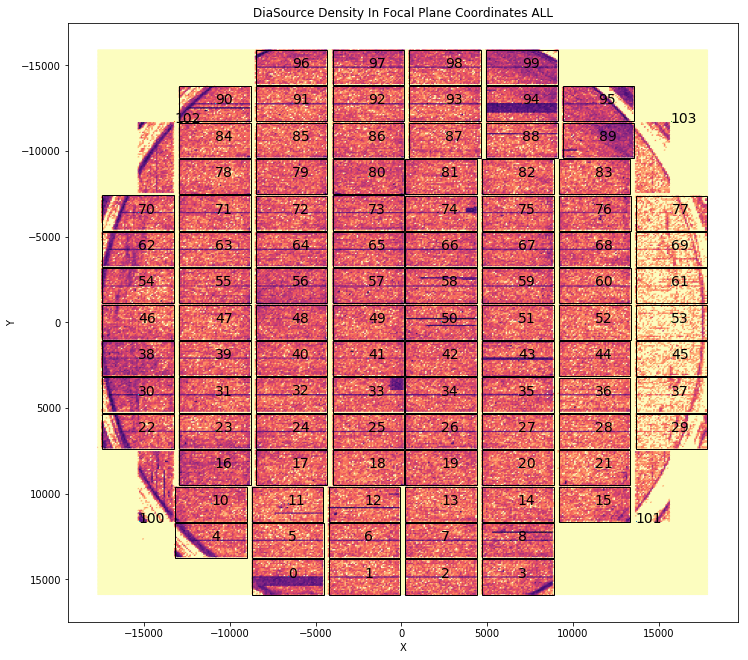

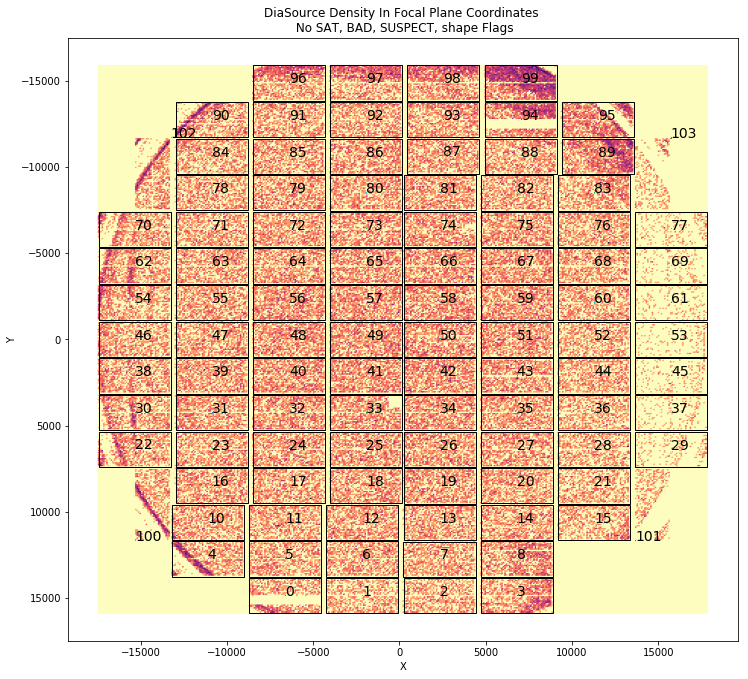

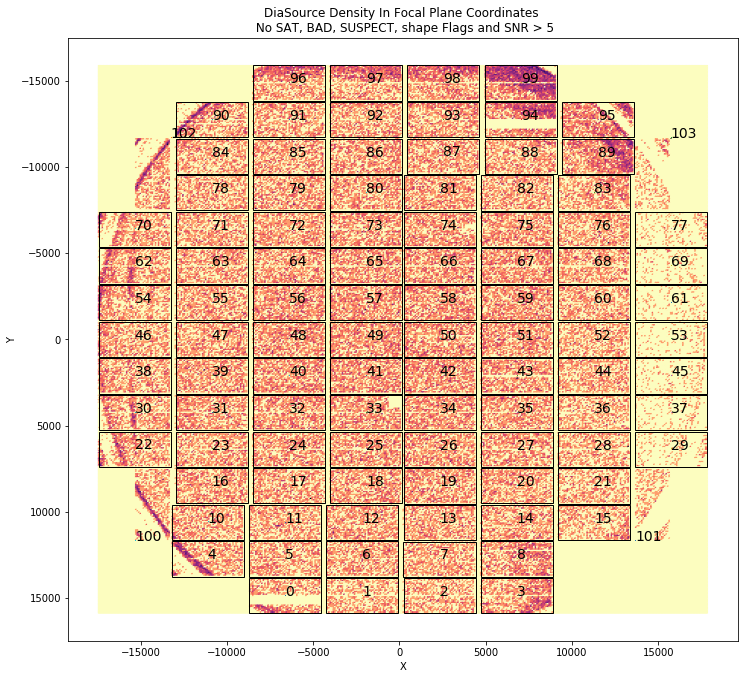

In [22]:
import matplotlib.patches as patches

fig1 = plt.figure(figsize=(12,12))
ax1 = fig1.add_subplot(111, aspect='equal')
for index, row in corners.iterrows():
    #print(row[2], row[3], -row.width, -row.height, row[2]-row.width/2, row[3]-row.height/2, '%d'%(row[1]))
    ax1.add_patch(
    patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
    ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
    plt.plot(row[7]-row.height/2, row[6]-row.width/2, ',')
ax1.hexbin(ds['yFP'], ds['xFP'], gridsize=(400,400), bins='log', cmap='magma_r')
ax1.set_title('DiaSource Density In Focal Plane Coordinates ALL')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1 = plt.gca()
ax1.invert_yaxis()
plt.show()
    
for ind, title in [
                   (idx, "No SAT, BAD, SUSPECT, shape Flags"),
                   (idxHighSNR, "No SAT, BAD, SUSPECT, shape Flags and SNR > 5")]:

    fig1 = plt.figure(figsize=(12,12))
    ax1 = fig1.add_subplot(111, aspect='equal')
    for index, row in corners.iterrows():
        #print(row[2], row[3], -row.width, -row.height, row[2]-row.width/2, row[3]-row.height/2, '%d'%(row[1]))
        ax1.add_patch(
        patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
        ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
        plt.plot(row[7]-row.height/2, row[6]-row.width/2, ',')
    ax1.hexbin(ds[idx]['yFP'], ds[idx]['xFP'], gridsize=(400,400), bins='log', cmap='magma_r')
    ax1.set_title('DiaSource Density In Focal Plane Coordinates \n %s' %(title))
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
    plt.show()

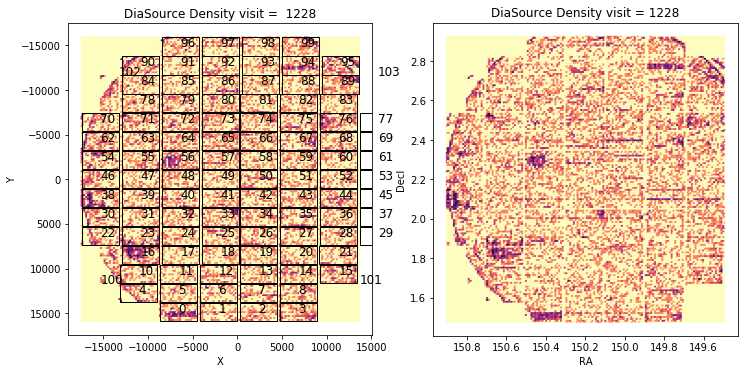

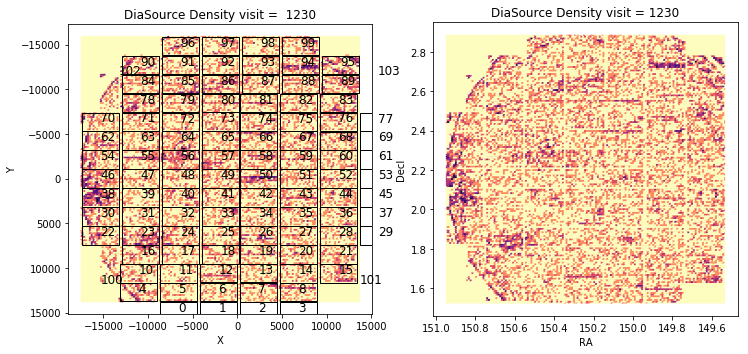

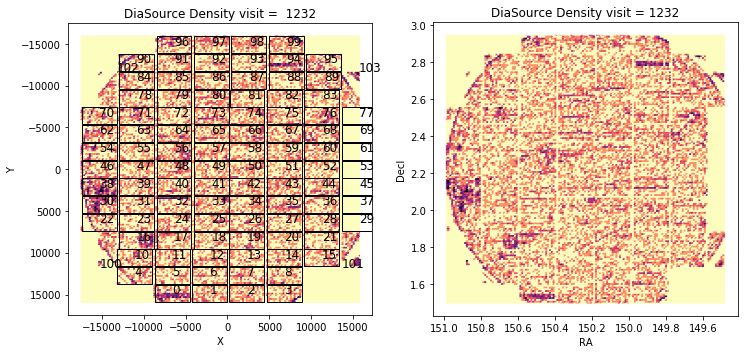

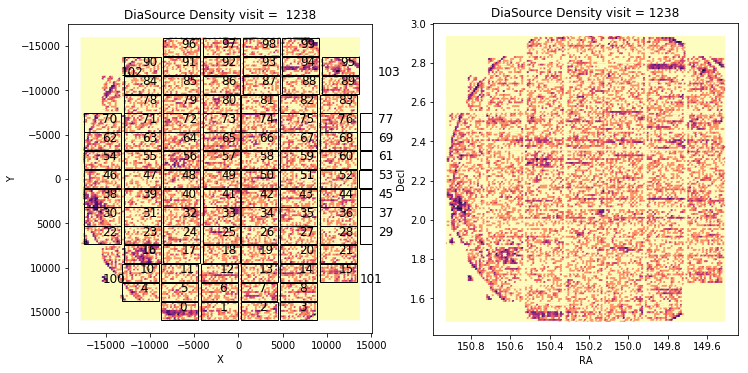

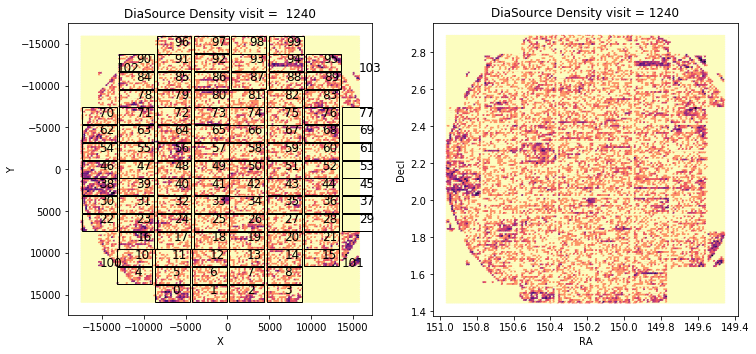

...

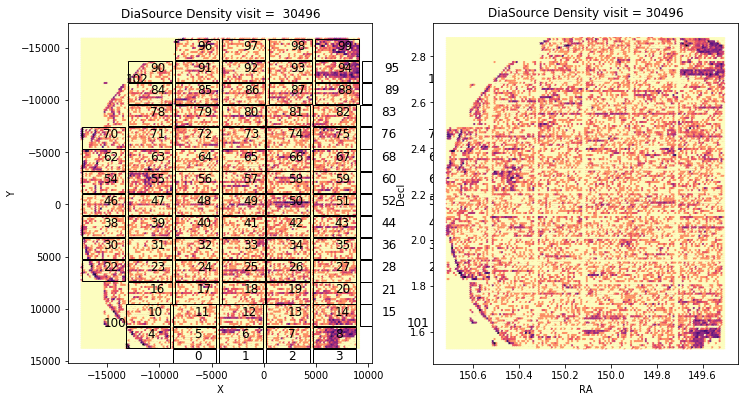

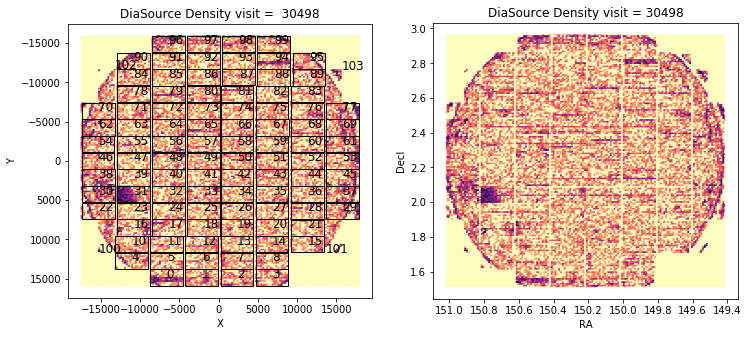

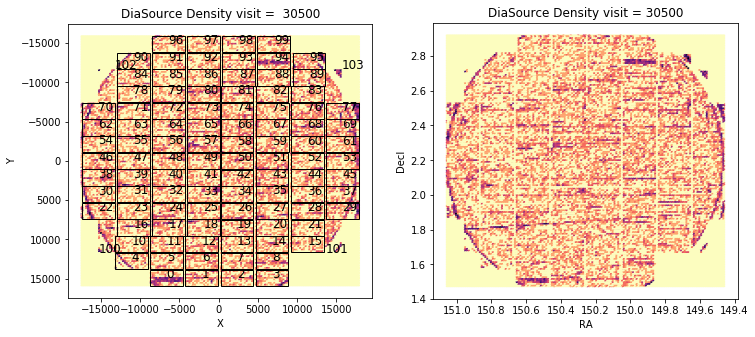

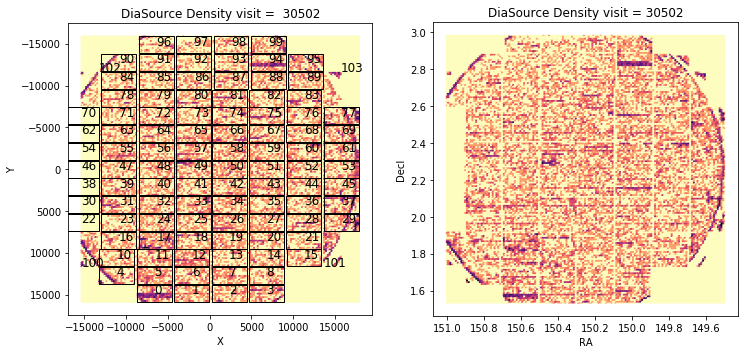

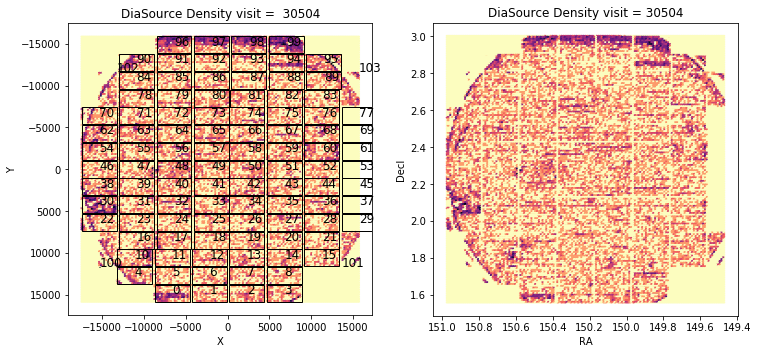

In [23]:
#PER VISIT
for v in np.unique(ds['visit'].values):
    ind = ds.visit == v
    fig1 = plt.figure(figsize=(12, 8))
    ax1 = fig1.add_subplot(121, aspect='equal')
    ax1.hexbin(ds.yFP[ind], ds.xFP[ind], gridsize=(150,150), bins='log', cmap='magma_r')
    for index, row in corners.iterrows():
        ax1.add_patch( patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
        ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=12)
    ax1.set_title('DiaSource Density visit =  %s' % v)
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1 = plt.gca()
    ax1.invert_yaxis()
    
    ax1 = fig1.add_subplot(122, aspect='equal')
    #for index, row in corners.iterrows():
    #    ax1.add_patch( patches.Rectangle((row[7], row[6]), - row.height, -row.width, fill=False))
    #    ax1.text(row[7]-row.height/2, row[6]-row.width/2, '%d'%(row[1]), fontsize=14)
    ax1.hexbin(ds.ra[ind], ds.decl[ind], gridsize=(150,150), bins='log', cmap='magma_r')
    ax1.set_title('DiaSource Density visit = %s' % v)
    ax1.set_xlabel('RA')
    ax1.set_ylabel('Decl')
    ax1 = plt.gca()
    ax1.invert_xaxis()
    plt.show()

    

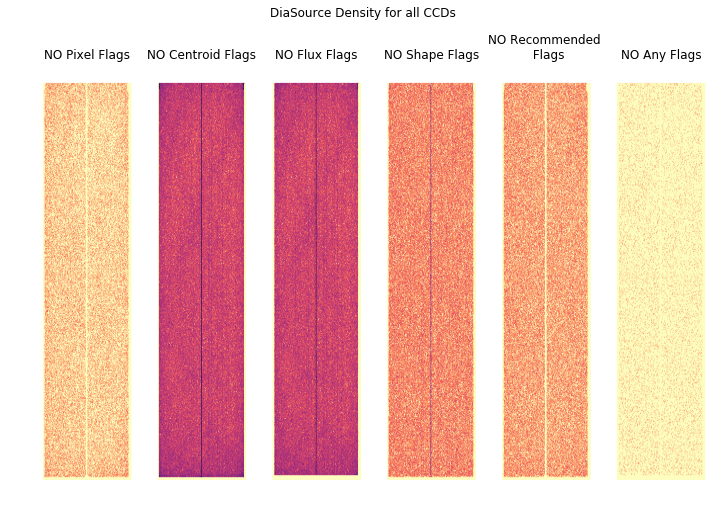

In [24]:
fig = plt.figure(figsize=(12, 8))
fig.suptitle('DiaSource Density for all CCDs')
for i, (flagNames, title) in enumerate(zip([pixelFlagNames, centroidFlagNames, fluxFlagNames, shapeFlagNames, badFlagNames, flag_names],
                                  ["Pixel Flags", "Centroid Flags", "Flux Flags", "Shape Flags", "Recommended \n Flags", "Any Flags"])):
    ax = fig.add_subplot(1,6,i+1)
    idx = flagDF[flagNames].sum(axis = 1) == 0 
    ax.hexbin(ds.x[idx], ds.y[idx], gridsize=(200,400), bins='log',
              extent= [0,2048,0,4096], cmap='magma_r',  vmin=1, vmax=100)
    ax.set_title('NO %s' %title)
    plt.axis('off')

(-102.40000225280002, 2150.4000022528003, -204.8, 4300.8)

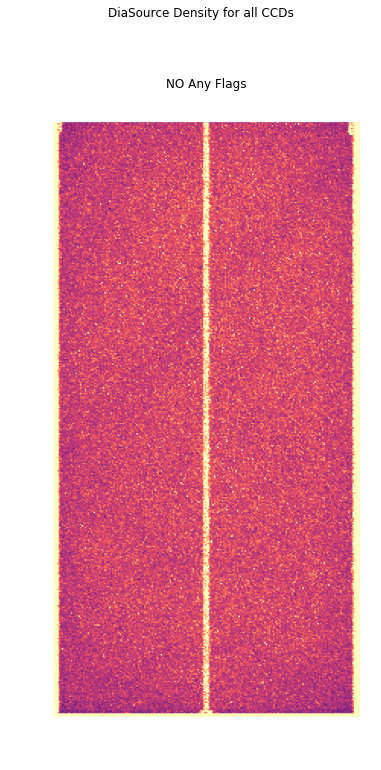

In [25]:
fig = plt.figure(figsize=(6, 12))
fig.suptitle('DiaSource Density for all CCDs')
ax = fig.add_subplot(1,1,1)
ax.hexbin(ds.x[~flagDF['base_PixelFlags_flag_bad']],
          ds.y[~flagDF['base_PixelFlags_flag_bad']], gridsize=(200,400), bins='log',
          extent= [0,2048,0,4096], cmap='magma_r',  vmin=1, vmax=100)
ax.set_title('NO %s' %title)
plt.axis('off')

In [26]:
ds['date_time'] = pd.to_datetime(ds.midPointTai, unit='D', origin=pd.Timestamp('1858-11-17'))
ds['date'] = ds['date_time'].dt.date
night_count = ds.groupby(('date', 'visit')).count()

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  This is separate from the ipykernel package so we can avoid doing imports until


# DiaSources per night


In [27]:
visits_per_night = night_count.groupby('date').count()
dia_per_night = night_count.groupby('date').sum()
pervisit_per_night = night_count.groupby('date').mean()
pervisit_per_night_std = night_count.groupby('date').std()

In [28]:
per_night = pd.merge(visits_per_night['x'], dia_per_night['x'], right_index=True, left_index=True)

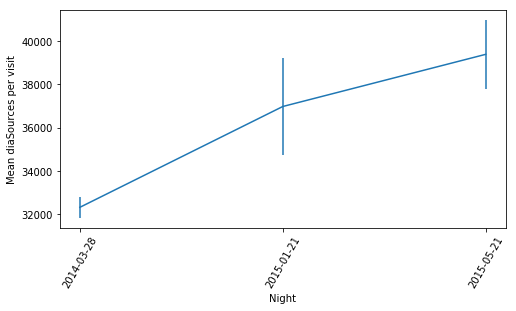

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


(0, 13)

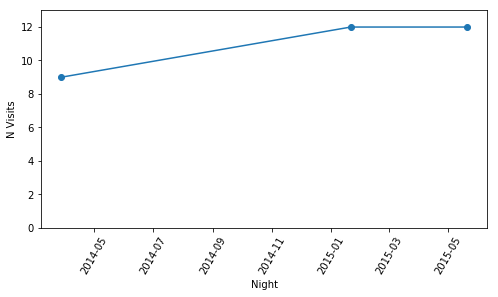

In [29]:
plt.figure(figsize=(8,4))
plt.errorbar(pervisit_per_night.index.values.astype('str'), pervisit_per_night['x'],
             yerr=pervisit_per_night_std['x']/np.sqrt(visits_per_night['x']))
#plt.xticks(pervisit_per_night.index.values.astype('str'))
_ = plt.xticks(rotation=60)
plt.xlabel('Night')
plt.ylabel('Mean diaSources per visit')
plt.show()
plt.figure(figsize=(8,4))
plt.plot(visits_per_night.index, visits_per_night['x'], 'o-')
_ = plt.xticks(rotation=60)
plt.xlabel('Night')
plt.ylabel('N Visits')
plt.ylim(0, np.max(visits_per_night['x'].values + 1))


# Conclusions

* Ran ap_pipe with default configs which are not appropriate given the major background offsets in the difference images.
* The major source of detections are:
    - Background mismatch
    - Ghosts and scattered light from bright stars
    - Cosmics (higher rate than DECam, but may be fixed already DM-20112)

* Investigate:
    - Why is the background matching not working? This is probably a misconfiguration, but could be a bug in zero point scaling: https://jira.lsstcorp.org/browse/DM-20484
    - Coaddition moves variance into the covariance. We probably need to rescale the variance here like we do in DetectCoaddSources and CompareWarp.
    - Did DM-20112 mitigate the cosmic rays? If not, think about ways to handle. 
    - Ways to distinguish ghosts and reflected light from astrophysical transients. 
    


# Appendix
## Flux Distributions

The offset between the psFlux measured on the diffim and the totFlux on the calexp looks like the zeropoint of the calexp and difference image aren't the same.

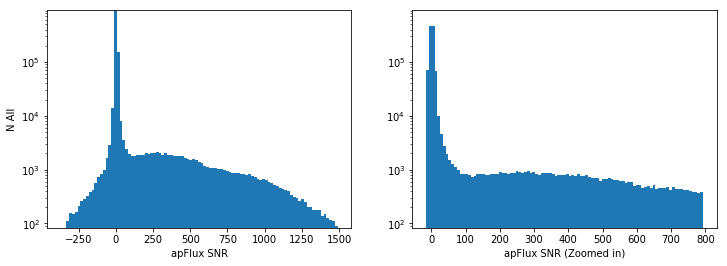

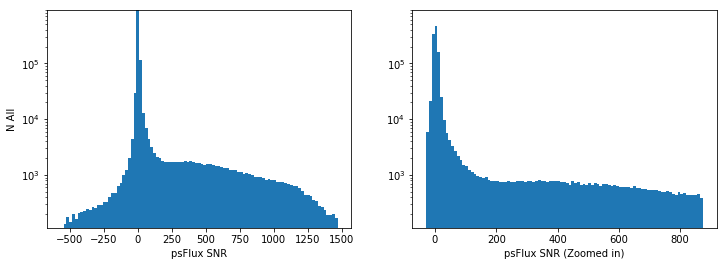

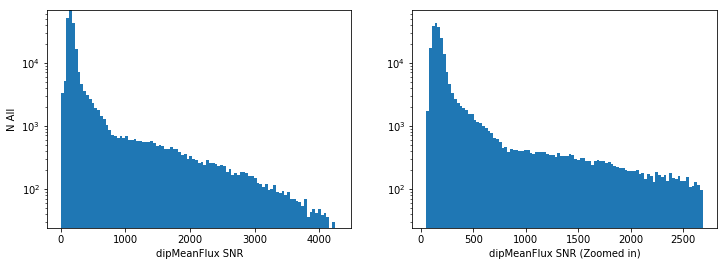

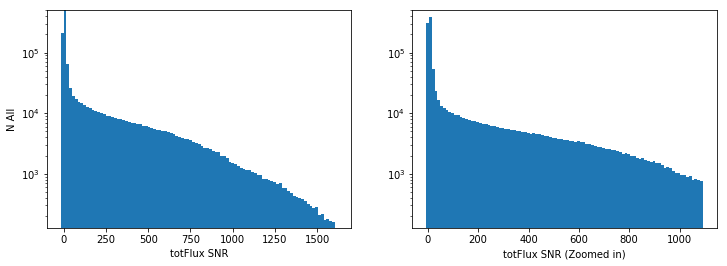

In [30]:
bins = np.linspace(-1000, 1000, 100)

fluxType = ["apFlux", "psFlux", "dipMeanFlux",
            "totFlux"]

for flux in fluxType:
    plt.figure(figsize = (12,4))
    arr = ds[flux]/ds[flux + "Err"]
    plt.subplot(121)

    low, high = np.percentile(arr[np.isfinite(arr)], (0.1, 99.9))
    y, x, patches = plt.hist(arr, bins=np.linspace(low, high, 100), log=True)
    plt.xlabel(flux + " SNR")
    plt.ylabel("N All")
    plt.ylim(np.min(y)+1, np.max(y)+10)
    plt.subplot(122)
    low, high = np.percentile(arr[np.isfinite(arr)], (1.5, 98.5))

    _ = plt.hist(arr, bins=np.linspace(low, high, 100), log=True)
    plt.xlabel(flux + " SNR (Zoomed in)")
    plt.ylim(np.min(y) +1 , np.max(y)+10)

    plt.show()

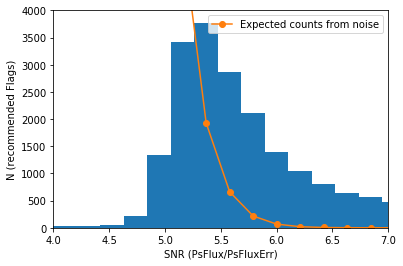

In [31]:
bins = np.linspace(4,8,20)
plt.xlim(4,7)
plt.ylim(0, 4000)
flux = "psFlux"
arr = ds[flux]/ds[flux + "Err"]
plt.hist(arr[idx], bins=bins)
plt.plot(0.5*(bins[:-1] + bins[1:]), expected(bins[:-1], bins[1:], 
                                              seeing=4/SIGMA2FWHM), 
         'o-', label="Expected counts from noise")
plt.ylabel("N (recommended Flags)")
plt.xlabel("SNR (PsFlux/PsFluxErr)")
plt.legend()
plt.show()

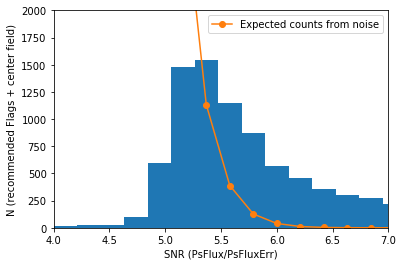

In [32]:
bins = np.linspace(4,8,20)
plt.xlim(4,7)
plt.ylim(0, 2000)
flux = "psFlux"
arr = ds[flux]/ds[flux + "Err"]
plt.hist(arr[idx & idxGoodCcd], bins=bins)
plt.plot(0.5*(bins[:-1] + bins[1:]), expected(bins[:-1], bins[1:], 
                                              seeing=4/SIGMA2FWHM, nCcds=33*N_GOOD_CCD), 
         'o-', label="Expected counts from noise")
plt.ylabel("N (recommended Flags + center field)")
plt.xlabel("SNR (PsFlux/PsFluxErr)")
plt.legend()
plt.show()

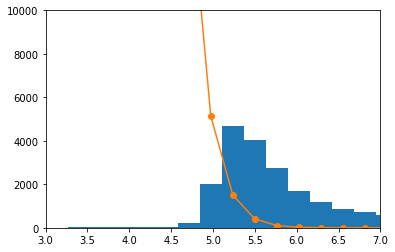

In [33]:
bins = np.linspace(3,8,20)
plt.xlim(3,7)
plt.ylim(0, 10000)
flux = "psFlux"
arr = ds[flux]/ds[flux + "Err"]
plt.hist(arr[idx], bins=bins)
plt.plot(0.5*(bins[:-1] + bins[1:]), expected(bins[:-1], bins[1:]), 'o-')
plt.show()

In [34]:
bins = np.linspace(4,6,8)
expected(bins[:-1], bins[1:])

array([1.65173496e+05, 5.63617540e+04, 1.75615917e+04, 5.00315475e+03,
       1.30460859e+03, 3.11634488e+02, 6.82415437e+01])

In [35]:
len(arr[(arr> 4.75) & (arr<5.25)])

56208

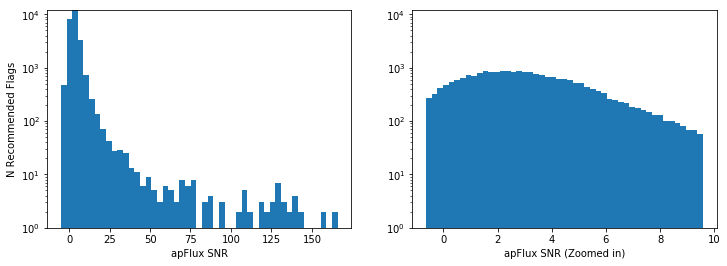

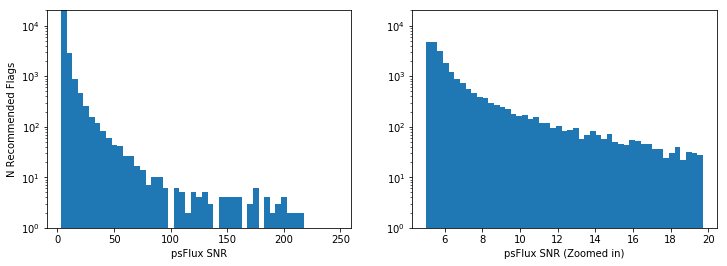

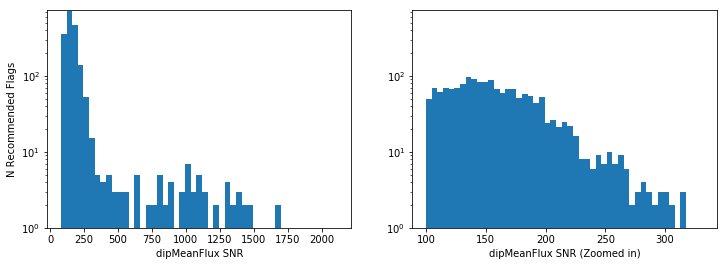

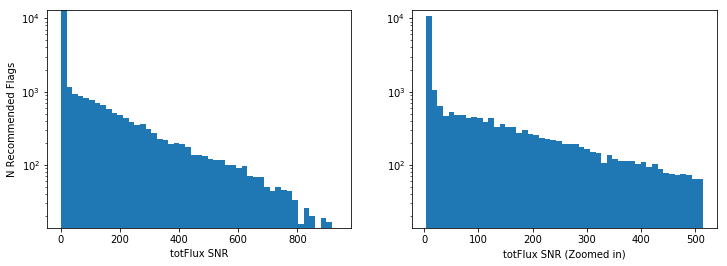

In [36]:

for flux in fluxType:
    plt.figure(figsize = (12,4))
    arr = ds[idx][flux]/ds[idx][flux + "Err"]
    plt.subplot(121)
    low, high = np.percentile(arr[np.isfinite(arr)], (0.1, 99.9))
    y, x, patches  = plt.hist(arr, bins=np.linspace(low, high, 50), log=True)
    plt.xlabel(flux + " SNR")
    plt.ylabel("N Recommended Flags")
    plt.ylim(np.min(y)+1, np.max(y)+10)
    plt.subplot(122)
    low, high = np.percentile(arr[np.isfinite(arr)], (5, 95))
    _ = plt.hist(arr, bins=np.linspace(low, high, 50), log=True)
    plt.xlabel(flux + " SNR (Zoomed in)")
    plt.ylim(np.min(y)+1, np.max(y)+10)
    plt.show()


/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in log10
  


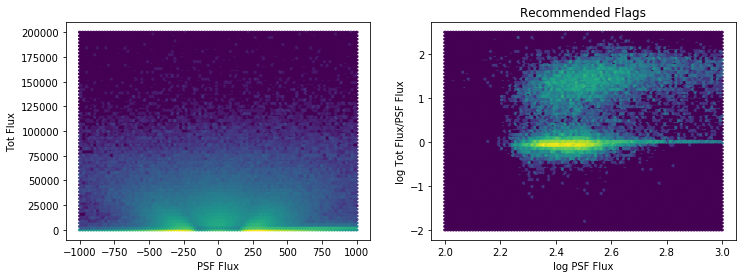

In [37]:
plt.figure(figsize = (12,4))
plt.subplot(121)
plt.hexbin(ds.psFlux, ds.totFlux, extent=(-1e3, 1e3, 0e5, 2e5), bins="log")
plt.xlabel("PSF Flux")
plt.ylabel("Tot Flux")

plt.subplot(122)
plt.hexbin(np.log10(ds.psFlux[idx]), np.log10(ds.totFlux[idx]/ ds.psFlux[idx]),
           extent=(2, 3, -2, 2.5), bins="log")
plt.xlabel("log PSF Flux")
plt.ylabel("log Tot Flux/PSF Flux")
plt.title("Recommended Flags")
plt.show()

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in log10
  if __name__ == '__main__':


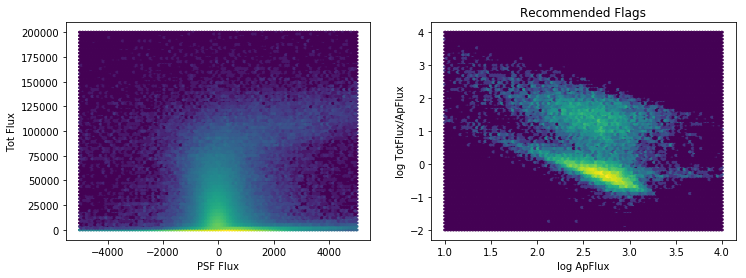

In [38]:
plt.figure(figsize = (12,4))
plt.subplot(121)

plt.hexbin(ds.apFlux, ds.totFlux, extent=(-5e3, 5e3, 0e5, 2e5), bins="log")
plt.xlabel("PSF Flux")
plt.ylabel("Tot Flux")
plt.subplot(122)

plt.hexbin(np.log10(ds.apFlux[idx]), np.log10(ds.totFlux[idx]/ds.apFlux[idx]),  extent=(1, 4, -2,4), bins="log")
plt.xlabel("log ApFlux")
plt.ylabel("log TotFlux/ApFlux")
plt.title("Recommended Flags")
plt.show()

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in log10
  import sys


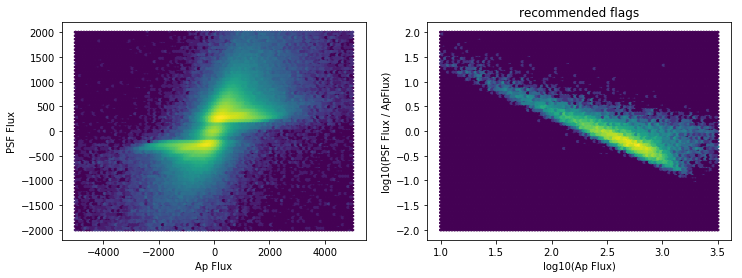

In [39]:
plt.figure(figsize = (12,4))
plt.subplot(121)
plt.hexbin(ds.apFlux, ds.psFlux, extent=(-5e3, 5e3, -2e3, 2e3), bins="log")
plt.xlabel("Ap Flux")
plt.ylabel("PSF Flux")
plt.subplot(122)
plt.hexbin(np.log10(ds.apFlux[idx]), np.log10(ds.psFlux[idx]/ds.apFlux[idx]) , extent=(1, 3.5, -2, 2),  bins="log")
plt.xlabel("log10(Ap Flux)")
plt.ylabel("log10(PSF Flux / ApFlux)")
plt.title("recommended flags")
plt.show()

In [40]:
len(np.unique(ds.ccdVisitId))

3064

In [41]:
#from lsst.pipe.tasks.scaleVariance import ScaleVarianceTask
# varianceScaling = []
#for ccdVisit in np.unique(ds.ccdVisitId):
#    visit = int(ccdVisit/200.)
#    ccd = int(np.round((ccdVisit/200. - visit)*200))
#    exp = butler.get('deepDiff_differenceExp', visit=int(visit), ccd=ccd)
#    varianceScaling.append((ccdVisit, visit, ccd, task.run(exp.getMaskedImage())))

#varianceDF = pd.DataFrame(varianceScaling)
# varianceDF.to_csv('varianceDF.csv')
varianceDF = pd.DataFrame.from_csv('varianceDF.csv')

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:11: FutureWarning: from_csv is deprecated. Please use read_csv(...) instead. Note that some of the default arguments are different, so please refer to the documentation for from_csv when changing your function calls
  # This is added back by InteractiveShellApp.init_path()


Text(0.5, 0, 'empirical variance ratio (from ScaleVarianceTask)')

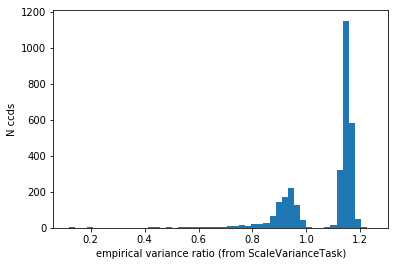

In [42]:
varianceDF.columns = ["ccdVisit", 'visit', 'ccd', 'scale']
_ = plt.hist(varianceDF["scale"], bins=50)
plt.ylabel('N ccds')
plt.xlabel("empirical variance ratio (from ScaleVarianceTask)")

In [43]:
varianceScale = varianceDF.groupby('visit')
varianceMedian = varianceScale.scale.median()
varianceMin = varianceScale.scale.min()
varianceMax = varianceScale.scale.max()
varianceStd = varianceScale.scale.std()

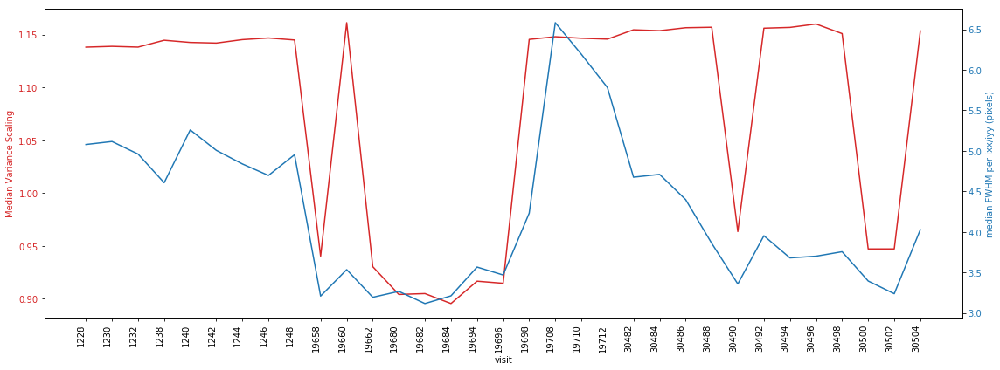

In [44]:
vgrp = ds.groupby('visit')
vgrpClean = ds[idx].groupby('visit')
vgrpCleanCenter = ds[idx & idxGoodCcd].groupby('visit')
vgrpHighSNR = ds[idxHighSNR].groupby('visit')
plot2axes(varianceScale.median().index, varianceScale.median().scale,
          vgrpClean.visit.first().values, vgrpClean.seeing.median().values,
          'visit','Median Variance Scaling',
          'median FWHM per ixx/iyy (pixels)')


In [45]:
ds.groupby(('ccdVisitId', 'visit', 'ccd')).count().reset_index().sort_values('x')[['visit', 'ccd', 'x']].head()

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  """Entry point for launching an IPython kernel.


,visit,ccd,x
1799,19710,5,116
1800,19710,6,123
1716,19708,17,129
1790,19708,98,140
1729,19708,31,143


In [46]:
countsDF = ds.groupby(('ccdVisitId', 'visit', 'ccd')).count().reset_index()
countsDF.sort_values('x')[['visit', 'ccd', 'x']].head()
#ds.groupby(('ccdVisitId', 'visit', 'ccd')).count().reset_index().sort_values('x')[['visit', 'ccd', 'x']].tail()

/software/lsstsw/stack_20190330/python/miniconda3-4.5.12/envs/lsst-scipipe/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  """Entry point for launching an IPython kernel.


,visit,ccd,x
1799,19710,5,116
1800,19710,6,123
1716,19708,17,129
1790,19708,98,140
1729,19708,31,143


In [47]:
countsDF[countsDF.ccd.isin(goodCcds)].sort_values('x')[['visit', 'ccd', 'x']].tail()

,visit,ccd,x
15,1228,16,852
1625,19698,16,897
2888,30502,17,1003
2143,30484,83,1224
2696,30498,31,1834


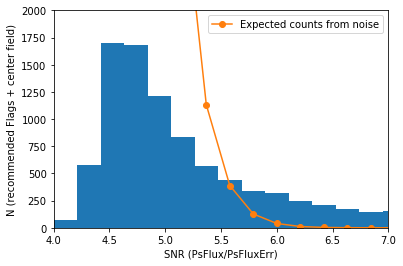

In [48]:
bins = np.linspace(4,8,20)
plt.xlim(4,7)
plt.ylim(0, 2000)
flux = "psFlux"
arr = ds[flux]/ds[flux + "Err"]/varianceDF.scale.median()
plt.hist(arr[idx & idxGoodCcd], bins=bins)
plt.plot(0.5*(bins[:-1] + bins[1:]), expected(bins[:-1], bins[1:], 
                                              seeing=4/SIGMA2FWHM, nCcds=33*N_GOOD_CCD), 
         'o-', label="Expected counts from noise")
plt.ylabel("N (recommended Flags + center field)")
plt.xlabel("SNR (PsFlux/PsFluxErr)")
plt.legend()
plt.show()